In [1]:
import os
import sys
import numpy as np
import pandas as pd
from string import ascii_uppercase

import matplotlib.pyplot as plt
from matplotlib import colormaps
from matplotlib.collections import PatchCollection
from matplotlib.colors import to_rgba
from matplotlib.patches import Circle
from sklearn.metrics import adjusted_rand_score

%matplotlib inline

sys.path.append('/mnt/data1/spatial/tissue-alignment/traversal')
from io_utils import read_image, read_spatial_data, read_transcription_data, read_embedding_data
from plot import draw_start, draw_path, draw_clusters
from graph import compute_distance_matrix, compute_path_idxs, compute_clusters, compute_path_counts

In [2]:
model = 'triplet-gi-0999'
fullres = False

In [3]:
alignment_genes = ['EPCAM', 'ACTA2']

In [4]:
cd_ins = [
    ('CD', 'A', 2462, 524,  'left', 'bottom'),
    ('CD', 'B', 2612, 1144, 'left', 'top'),
    ('CD', 'C', 3257, 1863, 'left', 'bottom'),
    ('CD', 'D', 105,  3028, 'left', 'right'),
]

uc_ins = [
    ('UC', 'A', 2525, 213,  'top',    'right'),
    ('UC', 'B', 241,  3601, 'right',  'left'),
    ('UC', 'C', 127,  2366, 'top',    'bottom'),
    ('UC', 'D', 2374, 2591, 'bottom', 'top'),
]

In [5]:
def draw_circles(spot_radius, pos_df, alpha):
    circs = PatchCollection(
        [Circle((x, y), spot_radius) for x, y in pos_df[["x", "y"]].to_numpy()],
        picker=True,
    )
    facecolors = np.asarray([list(to_rgba("lightgray"))] * len(pos_df))
    edgecolors = np.asarray([list(to_rgba("darkgray"))] * len(pos_df))
    alphas = np.full(len(pos_df), alpha)
    circs.set_facecolor(facecolors)
    circs.set_edgecolor(edgecolors)
    circs.set_alpha(alphas)
    return circs, facecolors, edgecolors, alphas

In [17]:
def align_disease(title, dz_ins, fignum):
    figsize = 8
    fontsize=15
    alpha = 1
    nrows = len(dz_ins)
    ncols = 6
    plt.close()
    fig, axs = plt.subplots(nrows, ncols, figsize=(figsize * ncols, figsize * nrows))
    for ax in axs.flatten():
        ax.set_axis_off()

    dz_temp = []
    aris = []
    for i, (dz, section, start_idx, end_idx, start_label, end_label) in enumerate(dz_ins):
        print(section)
        # ATAT alignment
        section_path = f'/mnt/data1/spatial/data/colon/{dz}/{section}'
        im = read_image(section_path, fullres)
        pos_df, spot_radius = read_spatial_data(section_path, fullres)
        embeds = read_embedding_data(section_path, model)
        counts = read_transcription_data(section_path)
        # print(f'{dz}/{section} average normalized expression per spot: {counts.sum().sum() / len(pos_df)}')
        dists, hex = compute_distance_matrix(embeds, pos_df)
        path_idxs = compute_path_idxs(dists, hex, start_idx, end_idx)
        clusters = compute_clusters(embeds, embeds[path_idxs])
        if not os.path.exists(f'colon/colon_{dz}_{section}_counts.csv'):
            path_counts, _ = compute_path_counts(pos_df, counts, path_idxs, clusters)
            path_counts.to_csv(f'colon/colon_{dz}_{section}_counts.csv', index=False)
        else:
            path_counts = pd.read_csv(f'colon/colon_{dz}_{section}_counts.csv')

        boundary_file=f'colon/colon-{dz}-{section}-boundaries.npy'
        temp = np.load(boundary_file, allow_pickle=True)
        bounds = []
        pos_df['bound'] = -1 # sentinel
        for j, b in enumerate(temp):
            # convert row, col matrix to list of indices
            mask = [f'{row}-{col}' for row, col in b]
            row_col = pd.DataFrame(
                {'idx': np.arange(len(pos_df))},
                index=pos_df['row'].astype(str) + "-" + pos_df['col'].astype(str)
            )
            bounds.append(row_col.loc[mask, 'idx'].to_numpy())
            pos_df.loc[bounds[-1], 'bound'] = j

        # Manual segmentation
        layers = pd.read_csv(f'colon/colon-{dz}-{section}-layers.csv')
        pos_df['layer'] = layers['layer']

        # ATAT pseudosegmentation
        prev_layer = 0
        path_bounds = [0]
        for j, path_idx in enumerate(path_idxs[1:]):
            j += 1
            cur_layer = pos_df.loc[path_idx, 'bound']
            if cur_layer == -1 or cur_layer == len(bounds) - 1:
                continue
            if cur_layer != prev_layer:
                path_bounds.append(j+1)
                prev_layer = cur_layer
        assert len(path_bounds) == len(pos_df['bound'].drop_duplicates()) - 2 # account for sentinel and L+1 boundaries for L layers
        path_bounds.append(len(path_idxs))
        cluster_to_layer = {}
        layer = 0
        for j in range(len(path_idxs)):
            if j == path_bounds[layer + 1]:
                layer += 1
            cluster_to_layer[j] = layer
        pos_df['atat-layer'] = [cluster_to_layer[c] for c in clusters]

        # Belayer alignment and segmentation
        belayer = pd.read_csv(f'colon/colon-{dz}-{section}-belayer.csv')
        pos_df[['depth', 'depth2', 'belayer-layer']] = belayer[['depth', 'depth2', 'belayer-layer']]

        # Compute ARI
        atat_ari = adjusted_rand_score(pos_df['layer'], pos_df['atat-layer'])
        belayer = pd.read_csv(f'colon/colon-{dz}-{section}-belayer.csv')
        belayer_ari = adjusted_rand_score(pos_df['layer'], belayer['belayer-layer'])
        aris.append((atat_ari, belayer_ari))

        # Draw hexagonal grid over grayscale H&E
        row_circs = []
        for ax in axs[i, 1:]:
            ax.imshow(np.asarray(im.convert("L")), cmap='gray', vmin=0, vmax=255)
            circs_etc = draw_circles(spot_radius, pos_df, alpha)
            row_circs.append(circs_etc)
            ax.add_collection(circs_etc[0])

        # Draw boundaries over color H&E
        ax1 = axs[i, 0]
        ax1.imshow(im)
        cmap = colormaps['tab10']
        for j, b in enumerate(bounds):
            bound_coords = pos_df.loc[b, ['x', 'y']].sort_values('y').to_numpy()
            for x, y in bound_coords:
                circ = Circle((x, y), spot_radius, color=cmap(j))
                ax1.add_artist(circ)

        dz_temp.append((pos_df, start_idx, row_circs, path_idxs, clusters, start_label, end_label, bounds))

    fig.tight_layout()
    fig.subplots_adjust(top=0.965)
    ax1, ax2, ax3, ax4, ax5, ax6 = axs[0]

    ax1.set_title('Annotated Boundaries', fontsize=fontsize*2)
    ax2.set_title('Belayer Alignment', fontsize=fontsize*2)
    ax3.set_title('ATAT Alignment', fontsize=fontsize*2)
    ax4.set_title('Manual Segmentation', fontsize=fontsize*2)
    ax5.set_title('Belayer Segmentation', fontsize=fontsize*2)
    ax6.set_title('ATAT Segmentation', fontsize=fontsize*2)

    ax3_bbox = ax3.get_position()
    ax4_bbox = ax4.get_position()
    title_x = (ax3_bbox.xmax - ax4_bbox.xmin) / 2 + ax3_bbox.xmax
    fig.text(title_x, 0.995, title, fontsize=fontsize*2, va='top', ha='center')

    def _panel_label_coords(bbox, xoffset=0.01, yoffset=0.01):
        x = bbox.width * xoffset + bbox.xmin
        y = bbox.ymax - bbox.height * yoffset
        return x, y

    for ax, letter in zip(axs.flatten(), ascii_uppercase):
        fig.text(*_panel_label_coords(ax.get_position()), letter, ha='left', va='top', fontsize=fontsize*2, weight='bold')

    for i, (pos_df, start_idx, row_circs, path_idxs, clusters, start_label, end_label, bounds) in enumerate(dz_temp):
        ax1, ax2, ax3, ax4, ax5, ax6 = axs[i]

        # Draw Belayer Alignment
        circs, facecolors, edgecolors, alphas = row_circs[0]
        dummy_path_idxs = [-1] * (pos_df['depth2'].max() + 1)
        draw_clusters(
            fig=fig,
            ax=ax2,
            path_idxs=dummy_path_idxs,
            clusters=pos_df['depth2'],
            circs=circs,
            facecolors=facecolors,
            edgecolors=edgecolors,
            cm_name='gist_rainbow',
            fontsize=fontsize,
        )

        # Draw ATAT Alignment
        circs, facecolors, edgecolors, alphas = row_circs[1]
        draw_start(ax3, pos_df, start_idx, start_label, circs, edgecolors, fontsize=fontsize)
        draw_path(ax3, pos_df, path_idxs, end_label, circs, edgecolors, fontsize=fontsize)
        draw_clusters(fig, ax3, path_idxs, clusters, circs, facecolors, edgecolors=edgecolors, fontsize=fontsize)

        # Draw True Segmentation
        circs, facecolors, edgecolors, alphas = row_circs[2]
        dummy_path_idxs_seg = [-1] * (len(bounds)-1)
        draw_clusters(
            fig=fig,
            ax=ax4,
            path_idxs=dummy_path_idxs_seg,
            clusters=pos_df['layer'].astype(int),
            circs=circs,
            facecolors=facecolors,
            edgecolors=edgecolors,
            cm_name='tab10',
            show_cbar=False,
            discrete_cm=True,
            fontsize=fontsize,
        )

        # Draw Belayer Segmentation
        circs, facecolors, edgecolors, alphas = row_circs[3]
        dummy_path_idxs_seg = [-1] * (len(bounds)-1)
        draw_clusters(
            fig=fig,
            ax=ax5,
            path_idxs=dummy_path_idxs_seg,
            clusters=pos_df['belayer-layer'].astype(int),
            circs=circs,
            facecolors=facecolors,
            edgecolors=edgecolors,
            cm_name='tab10',
            show_cbar=False,
            discrete_cm=True,
            fontsize=fontsize,
        )

        # Draw ATAT Segmentation
        circs, facecolors, edgecolors, alphas = row_circs[4]
        dummy_path_idxs_seg = [-1] * (len(bounds)-1)
        draw_clusters(
            fig=fig,
            ax=ax6,
            path_idxs=dummy_path_idxs_seg,
            clusters=pos_df['atat-layer'].astype(int),
            circs=circs,
            facecolors=facecolors,
            edgecolors=edgecolors,
            cm_name='tab10',
            show_cbar=False,
            discrete_cm=True,
            fontsize=fontsize,
        )

    fig.savefig(f'figs/fig{fignum}.png')
    fig.savefig(f'figs/fig{fignum}.pdf')
    return aris

A
B
C


D


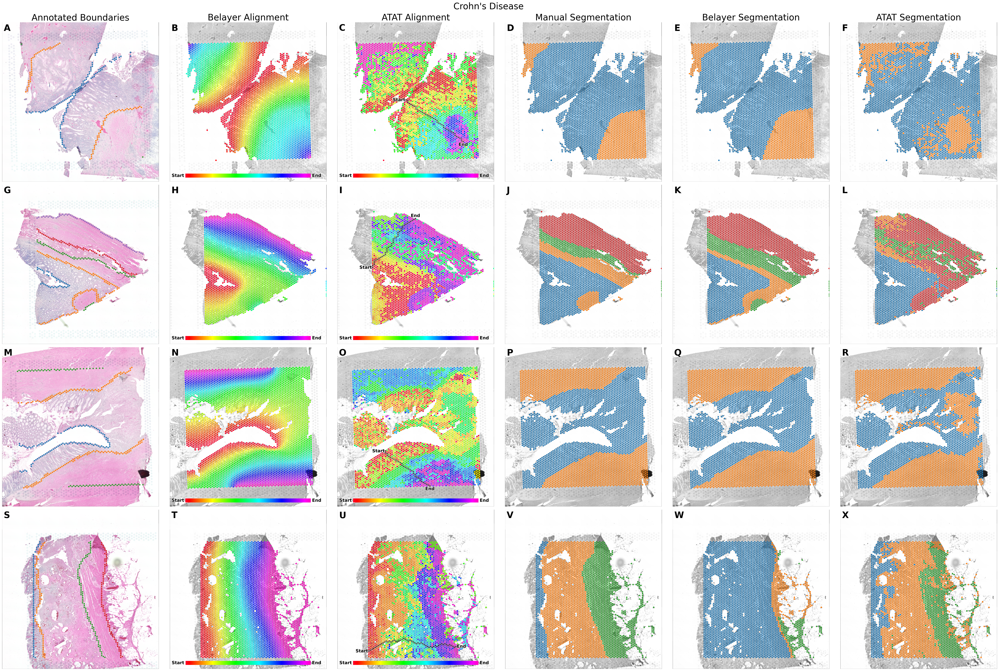

In [18]:
cd_aris = align_disease('Crohn\'s Disease', cd_ins, 'S1')

A
B


C
D


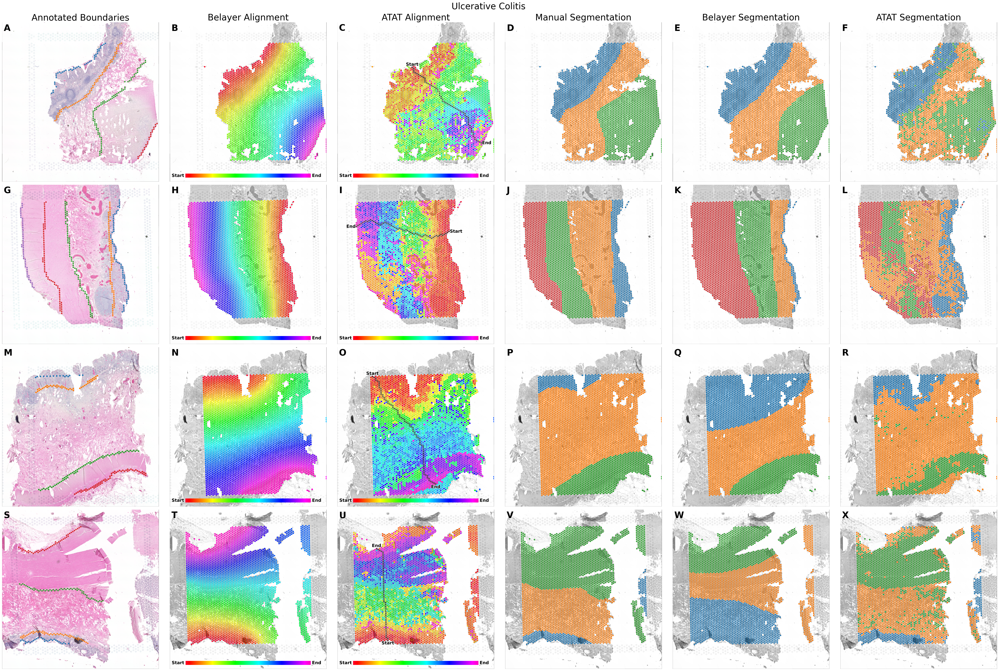

In [19]:
uc_aris = align_disease('Ulcerative Colitis', uc_ins, 'S2')

In [20]:
ARIs = pd.DataFrame(np.asarray(cd_aris+uc_aris), columns=['ATAT', 'Belayer'], index=pd.MultiIndex.from_product([['CD', 'UC'], list('ABCD')], names=['Disease', 'Section']))
ARIs.to_csv('colon-ARIs.csv')

In [21]:
ARIs[['ATAT', 'Belayer']].mean()

ATAT       0.429097
Belayer    0.573562
dtype: float64